## Homework Assignment 9

**Question 1:** Select a short video with at least 3 persons and create a new movie from this video with a face tracker (each person’s face needs to be tracked by a rectangle of a different color) (50pt). See, for example, the video in: https://github.com/ageitgey/face_recognition

**Bonus:** Select a video with at least two animals (dog/cat/lion/tiger...), and create a video with an animal tracker (10pt).

In [ ]:
# install face_recognition and opencv libraries - for the face tracker
!pip install face_recognition
!pip install opencv-python

In [ ]:
# install libraries - for the face tracker

!pip install imageai --upgrade
!pip install tensorflow==2.4.0
!pip install keras==2.4.3 numpy==1.19.3 pillow==7.0.0 scipy==1.4.1 h5py==2.10.0 matplotlib==3.3.2 opencv-python keras-resnet==0.2.0

In [ ]:
from google.colab import drive
drive._mount('/content/drive')

Mounted at /content/drive


### **Face tracker on friends scene**

In [ ]:
# import libraries
import face_recognition
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

In [ ]:
# Open the input movie file
input_movie = cv2.VideoCapture("./drive/MyDrive/BigData_Course/Friends/Friends_Scene.mp4")
length = int(input_movie.get(cv2.CAP_PROP_FRAME_COUNT))

# Create an output movie file (make sure resolution/frame rate matches input video!)
fourcc = cv2.VideoWriter_fourcc('M', 'J', 'P', 'G')
output_movie = cv2.VideoWriter('face_tracker.mp4', fourcc, 23.98, (1920, 1080))

In [ ]:
# check if the file has loaded
if input_movie.isOpened() == False:
  print("Error opening video stream or file.")

# split video into frames
frame_counter = 0
while input_movie.isOpened():
  ret, frame = input_movie.read()
  
  if ret == True:
    cv2_imshow(frame)
    frame_counter += 1
    
  else:
    break

  if frame_counter == 10:
    break
    
input_movie.release()
cv2.destroyAllWindows() 

In [ ]:
# Load some sample pictures and learn how to recognize them.
friends = ["Chandler Bing", "Rachel Green", "Joey Tribiani"]
friends_faces_urls = [
                      "./drive/MyDrive/BigData_Course/Friends/Chandler Bing.png",
                      "./drive/MyDrive/BigData_Course/Friends/Rachel Green.PNG",
                      "./drive/MyDrive/BigData_Course/Friends/Joey Tribbiani.PNG"            
]

# encode faces 
known_faces = []
for url in friends_faces_urls:
  face_image = face_recognition.load_image_file(url)
  face_encoding = face_recognition.face_encodings(face_image)[0]
  known_faces.append(face_encoding)

In [ ]:
# Initialize some variables
face_locations = []
face_encodings = []
face_names = []
frame_number = 0

while True:
    # Grab a single frame of video
    ret, frame = input_movie.read()
    frame_number += 1

    # Quit when the input video file ends
    if not ret:
        break

    # Convert the image from BGR color (which OpenCV uses) to RGB color (which face_recognition uses)
    rgb_frame = frame[:, :, ::-1]

    # Find all the faces and face encodings in the current frame of video
    face_locations = face_recognition.face_locations(rgb_frame)
    face_encodings = face_recognition.face_encodings(rgb_frame, face_locations)

    face_names = []
    for face_encoding in face_encodings:
        # See if the face is a match for the known face(s)
        match = face_recognition.compare_faces(known_faces, face_encoding, tolerance=0.50)
        
        # get the friend's name by his face
        name = None
        try:
          name = friends[match.index(True)]
          face_names.append(name)
        except Exception as e:
          pass

    # Label the results
    for (top, right, bottom, left), name in zip(face_locations, face_names):
        if not name:
            continue

        # Draw a box around the face
        if name == friends[0]:
          cv2.rectangle(frame, (left, top), (right, bottom), (0, 0, 255), 2)
          cv2.rectangle(frame, (left, bottom - 25), (right, bottom), (0, 0, 255), cv2.FILLED)
        elif name == friends[1]:
          cv2.rectangle(frame, (left, top), (right, bottom), (0, 255, 0), 2)
          cv2.rectangle(frame, (left, bottom - 25), (right, bottom), (0, 255, 0), cv2.FILLED)
        else:
          cv2.rectangle(frame, (left, top), (right, bottom), (255, 0, 0), 2)
          cv2.rectangle(frame, (left, bottom - 25), (right, bottom), (255, 0, 0), cv2.FILLED)

        # Draw a label with a name below the face
        font = cv2.FONT_HERSHEY_DUPLEX
        cv2.putText(frame, name, (left + 6, bottom - 6), font, 0.5, (255, 255, 255), 1)

    # Write the resulting image to the output video file
    print("Writing frame {} / {}".format(frame_number, length))
    output_movie.write(frame)

# All done!
input_movie.release()
output_movie.release()
cv2.destroyAllWindows()

Writing frame 1 / 465
Writing frame 2 / 465
Writing frame 3 / 465
Writing frame 4 / 465
Writing frame 5 / 465
Writing frame 6 / 465
Writing frame 7 / 465
Writing frame 8 / 465
Writing frame 9 / 465
Writing frame 10 / 465
Writing frame 11 / 465
Writing frame 12 / 465
Writing frame 13 / 465
Writing frame 14 / 465
Writing frame 15 / 465
Writing frame 16 / 465
Writing frame 17 / 465
Writing frame 18 / 465
Writing frame 19 / 465
Writing frame 20 / 465
Writing frame 21 / 465
Writing frame 22 / 465
Writing frame 23 / 465
Writing frame 24 / 465
Writing frame 25 / 465
Writing frame 26 / 465
Writing frame 27 / 465
Writing frame 28 / 465
Writing frame 29 / 465
Writing frame 30 / 465
Writing frame 31 / 465
Writing frame 32 / 465
Writing frame 33 / 465
Writing frame 34 / 465
Writing frame 35 / 465
Writing frame 36 / 465
Writing frame 37 / 465
Writing frame 38 / 465
Writing frame 39 / 465
Writing frame 40 / 465
Writing frame 41 / 465
Writing frame 42 / 465
Writing frame 43 / 465
Writing frame 44 / 4

In [ ]:
# load video with face recognition
from moviepy.editor import *

path="face_tracker.mp4" 

clip=VideoFileClip(path)
clip.ipython_display(width=800, height=600)

100%|██████████| 460/460 [00:17<00:00, 25.58it/s]


### **Bonus: Animal tracker**

In [ ]:
# load libraries for object detection
from imageai.Detection import VideoObjectDetection
import os

In [ ]:
# download yolo model
!wget https://github.com/OlafenwaMoses/ImageAI/releases/download/1.0/yolo.h5/ -O ./datasets/yolo.h5

In [ ]:
# create an object detection object
execution_path = './datasets'

detector = VideoObjectDetection()
detector.setModelTypeAsYOLOv3()
detector.setModelPath( os.path.join(execution_path , "yolo.h5"))
detector.loadModel()

# set only two categories to find
custom_objects = detector.CustomObjects(cat=True, dog=True)

# detect objects in video
video_path = detector.detectCustomObjectsFromVideo(
                custom_objects=custom_objects,
                input_file_path="./drive/MyDrive/BigData_Course/Animals/Dog and cat movie.mp4",
                output_file_path=os.path.join(execution_path, "animals_custom_detected"),
                frames_per_second=30.0, log_progress=True)

Processing Frame :  1
Processing Frame :  2
Processing Frame :  3
Processing Frame :  4
Processing Frame :  5
Processing Frame :  6
Processing Frame :  7
Processing Frame :  8
Processing Frame :  9
Processing Frame :  10
Processing Frame :  11
Processing Frame :  12
Processing Frame :  13
Processing Frame :  14
Processing Frame :  15
Processing Frame :  16
Processing Frame :  17
Processing Frame :  18
Processing Frame :  19
Processing Frame :  20
Processing Frame :  21
Processing Frame :  22
Processing Frame :  23
Processing Frame :  24
Processing Frame :  25
Processing Frame :  26
Processing Frame :  27
Processing Frame :  28
Processing Frame :  29
Processing Frame :  30
Processing Frame :  31
Processing Frame :  32
Processing Frame :  33
Processing Frame :  34
Processing Frame :  35
Processing Frame :  36
Processing Frame :  37
Processing Frame :  38
Processing Frame :  39
Processing Frame :  40
Processing Frame :  41
Processing Frame :  42
Processing Frame :  43
Processing Frame :  

In [ ]:
from moviepy.editor import *

clip=VideoFileClip(video_path)
clip.ipython_display(width=480, height=360)

100%|██████████| 292/292 [00:02<00:00, 98.29it/s] 


### **Facial mask classifier**

**Question 2:** Create an image classifier that can identify if a person in the image wears a facial mask (45pt). Evaluate the classifier precision (5pt)

In [ ]:
# load libraries
!apt install libnvrtc8.0
!pip uninstall -y mxnet-cu80 && pip install mxnet-cu80==1.1.0
!pip install turicreate

In [ ]:
import mxnet as mx
import turicreate as tc

# Use all GPUs (default)
tc.config.set_num_gpus(-1)

TuriCreate currently only supports using one GPU. Setting 'num_gpus' to 1.


In [ ]:
# Installing the Kaggle package
import json
!pip install kaggle 
!mkdir /root/.kaggle/

api_token = {"username":"*******","key":"***************"}

# creating kaggle.json file with the personal API-Key details 
with open('/root/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json

In [ ]:
# create directories and download data 
!mkdir ./datasets
!mkdir ./datasets/Masks

!kaggle datasets download -d vijaykumar1799/face-mask-detection -p ./datasets/Masks
!unzip ./datasets/Masks/*.zip -d ./datasets/Masks/

In [ ]:
# load images, set classes and split to train and test
DATASET_PATH = "./datasets/Masks/"

sf = tc.image_analysis.load_images(f"{DATASET_PATH}/Dataset/", with_path=True)
sf['class'] = sf['path'].apply(lambda path: 0 if "without_mask" in path else 1)

train_sf, test_sf = sf.random_split(0.8)

With mask: 


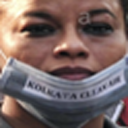

In [ ]:
# example of an image with mask
print("With mask: ")
sf[sf['class'] == 1]['image'][0]

Without mask: 


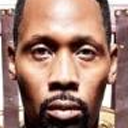

In [ ]:
# example of an image without mask
print("Without mask: ")
sf[sf['class'] == 0]['image'][0]

In [ ]:
train_sf.explore()

In [ ]:
# train an image classifier model
model = tc.image_classifier.create(train_sf['image','class'], target='class')
predictions = model.predict(test_sf['image','class'])

Download completed: /var/tmp/model_cache/resnet-50-TuriCreate-6.0.h5
Performing feature extraction on resized images...
Completed   64/7223
Completed  128/7223
Completed  192/7223
Completed  256/7223
Completed  320/7223
Completed  384/7223
Completed  448/7223
Completed  512/7223
Completed  576/7223
Completed  640/7223
Completed  704/7223
Completed  768/7223
Completed  832/7223
Completed  896/7223
Completed  960/7223
Completed 1024/7223
Completed 1088/7223
Completed 1152/7223
Completed 1216/7223
Completed 1280/7223
Completed 1344/7223
Completed 1408/7223
Completed 1472/7223
Completed 1536/7223
Completed 1600/7223
Completed 1664/7223
Completed 1728/7223
Completed 1792/7223
Completed 1856/7223
Completed 1920/7223
Completed 1984/7223
Completed 2048/7223
Completed 2112/7223
Completed 2176/7223
Completed 2240/7223
Completed 2304/7223
Completed 2368/7223
Completed 2432/7223
Completed 2496/7223
Completed 2560/7223
Completed 2624/7223
Completed 2688/7223
Completed 2752/7223
Completed 2816/7223


Logistic regression:

--------------------------------------------------------

Number of examples          : 6861

Number of classes           : 2

Number of feature columns   : 1

Number of unpacked features : 2048

Number of coefficients      : 2049

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 6        | 0.008764  | 2.849135     | 0.663606          | 0.632597            |

| 1         | 12       | 2.988639  | 5.190325     | 0.965603          | 0.966851            |

| 2         | 17       | 2.289065  | 7.214223     | 0.967497          | 0.964088            |

| 3         | 19       | 2.289065  | 8.315416     | 0.970121          | 0.969613            |

| 4         | 20       | 2.289065  | 9.066764     | 0.979303          | 0.972376            |

| 9         | 26       | 1.202049  | 13.252179    | 0.995919          | 0.997238            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

In [ ]:
# test model precision on the test set 
from sklearn.metrics import precision_score
print("Model precision is: ")
precision_score(list(test_sf['class']), list(predictions))

Model precision is: 


0.990924092409241

## Additional Question for Practice

**Question:** Select a collection of connected images. Create a graph of the links among images or objects in images (42pt). Use graph algorithms to discover interesting insights regarding the images. See, for example, [Figure 2](https://arxiv.org/pdf/1509.00568.pdf) (8pt).